In [1]:
import torch
import os
from sklearn.metrics import (
    classification_report,
    accuracy_score,
    roc_curve,
    auc,
    confusion_matrix,
)
from torchvision import datasets
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from recycling_app.preprocessing.loading_data import _split_train_val_test, _calculate_sizes
from recycling_app.model.soft_voting import SoftVoting

In [2]:
random_seed = 125

In [3]:
dataset_path = os.path.join(os.path.dirname(os.getcwd()), "data", "raw")
dataset = datasets.ImageFolder(dataset_path)
classes = dataset.classes

In [4]:
features_path = os.path.join(os.path.dirname(os.getcwd()), "data", "features")
features_path

'c:\\Users\\alicj\\Desktop\\praca_inz\\recycling_app\\backend\\data\\features'

In [5]:
test_features_resnet101 = torch.load(os.path.join(features_path, 'test_features_resnet101.pt'))
test_features_resnet152 = torch.load(os.path.join(features_path, 'test_features_resnet152.pt'))
test_features_vgg19 = torch.load(os.path.join(features_path, 'test_features_vgg19.pt'))

C:\Users\alicj\AppData\Local\Temp\ipykernel_10360\4107020394.py:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  test_features_resnet101 = torch.load(os.path.join(features_p

In [6]:
test_labels_resnet101 = torch.load(os.path.join(features_path, 'test_labels_resnet101.pt'))
test_labels_resnet152 = torch.load(os.path.join(features_path, 'test_labels_resnet152.pt'))
test_labels_vgg19 = torch.load(os.path.join(features_path, 'test_labels_vgg19.pt'))

C:\Users\alicj\AppData\Local\Temp\ipykernel_10360\3716384105.py:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  test_labels_resnet101 = torch.load(os.path.join(features_pat

In [7]:
test_features_vgg19 = test_features_vgg19.reshape(test_features_vgg19.shape[0], -1)

In [8]:
input = {
    'resnet101': test_features_resnet101,
    'resnet152': test_features_resnet152,
    'vgg19': test_features_vgg19
}

In [9]:
soft_voting = SoftVoting()

C:\Users\alicj\Desktop\praca_inz\recycling_app\backend\recycling_app\model\soft_voting.py:7: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.resnet101 = torch.load(os.pat

In [10]:
print(classification_report(test_labels_resnet101, soft_voting.predict(input)[0], target_names=classes))

               precision    recall  f1-score   support

    cardboard       0.84      0.86      0.85       166
food_organics       0.84      0.87      0.86        78
        glass       0.95      0.83      0.88       189
        metal       0.90      0.88      0.89       234
        paper       0.94      0.92      0.93       208
      plastic       0.83      0.89      0.86       281
      textile       0.90      0.82      0.86        67
        trash       0.73      0.78      0.75       141
   vegetation       0.93      0.93      0.93        91

     accuracy                           0.87      1455
    macro avg       0.87      0.86      0.87      1455
 weighted avg       0.87      0.87      0.87      1455



In [11]:
models_path = os.path.join(os.path.dirname(os.getcwd()), "recycling_app", "model")
models_path

'c:\\Users\\alicj\\Desktop\\praca_inz\\recycling_app\\backend\\recycling_app\\model'

In [12]:
nn_resnet101 = torch.load(os.path.join(models_path, 'nn_classifier_resnet101.pth'))
nn_resnet152 = torch.load(os.path.join(models_path, 'nn_classifier_resnet152.pth'))
nn_vgg19 = torch.load(os.path.join(models_path, 'nn_classifier_vgg19.pth'))

C:\Users\alicj\AppData\Local\Temp\ipykernel_10360\1695635528.py:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  nn_resnet101 = torch.load(os.path.join(models_path, 'nn_clas

In [13]:
pred_resnet101, prob_resnet101 = nn_resnet101.predict(test_features_resnet101)
pred_resnet152, prob_resnet152 = nn_resnet152.predict(test_features_resnet152)
pred_vgg19, prob_vgg19 = nn_vgg19.predict(test_features_vgg19)

In [14]:
def plot_metric_comparison(models_data, metric, classes):
    valid_metrics = ['precision', 'recall', 'f1-score']
    if metric not in valid_metrics:
        raise ValueError(f"Invalid metric. Choose one of {valid_metrics}")
    
    results = {model_name: [] for model_name in models_data.keys()}

    for model_name, (pred, true) in models_data.items():
        report = classification_report(true, pred, target_names=classes, output_dict=True)
        results[model_name] = [report[label][metric] for label in classes]

    n_models = len(models_data)
    n_classes = len(classes)
    bar_width = 0.15
    index = np.arange(n_classes)

    fig, ax = plt.subplots(figsize=(12, 6))
    ax.grid(True, which='both', axis='y', linestyle='--', linewidth=0.5, color='gray', alpha=0.7, zorder=0)
    ax.set_yticks(np.arange(0, 1.05, 0.05))
    ax.set_ylim(0, 1)
    
    for i, (model_name, model_results) in enumerate(results.items()):
        ax.bar(index + i * bar_width, model_results, bar_width, label=model_name, zorder=3)
    
    metric_pl = {
        'precision': 'Precyzja',
        'recall': 'Czułość',
        'f1-score': 'Miara F1'
    }

    ax.set_xlabel('Klasy', fontsize=12)
    ax.set_ylabel(f'{metric_pl[metric]}', fontsize=12)
    ax.set_title(f'Porównanie wyników pojedynczych NN na cechach z różnych modeli oraz Soft Votingu\n{metric_pl[metric]} ze względu na klasę', fontsize=16)
    ax.set_xticks(index + bar_width * (n_models - 1) / 2)
    ax.set_xticklabels(classes, fontsize=12)
    ax.legend(loc='lower right', fontsize=12)
    
    plt.tight_layout()
    plt.show()

In [15]:
models_data = {
    'ResNet101': (pred_resnet101, test_labels_resnet101),
    'ResNet152': (pred_resnet152, test_labels_resnet152),
    'VGG19': (pred_vgg19, test_labels_vgg19),
    'Soft Voting': (soft_voting.predict(input)[0], test_labels_resnet101)
}

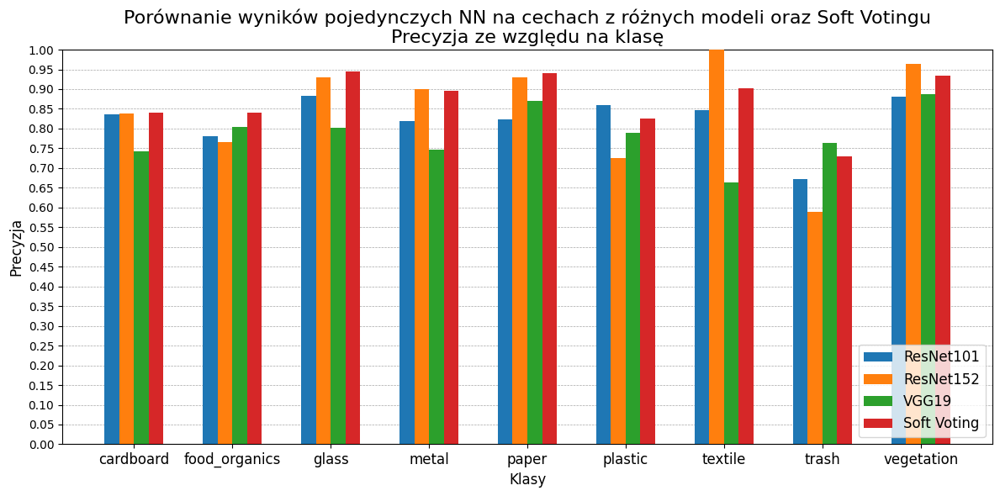

In [16]:
plot_metric_comparison(models_data, 'precision', classes)

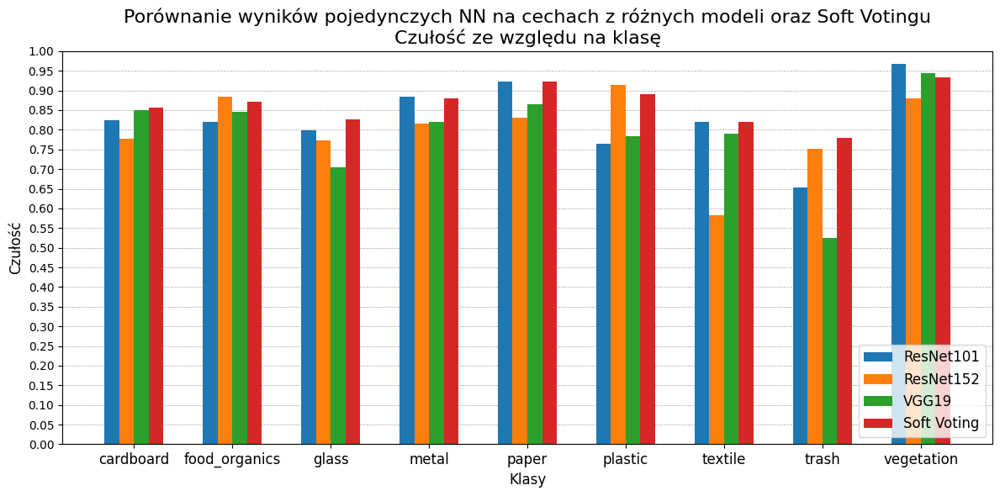

In [17]:
plot_metric_comparison(models_data, 'recall', classes)

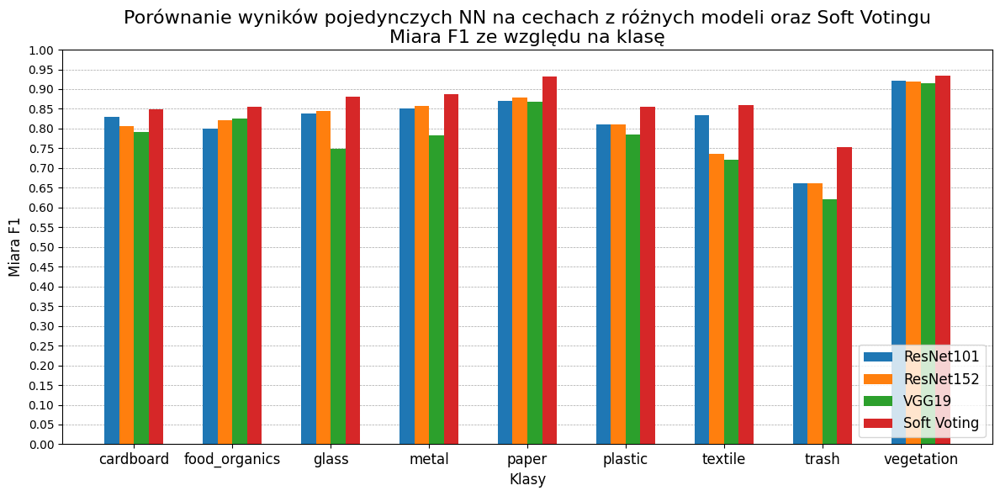

In [18]:
plot_metric_comparison(models_data, 'f1-score', classes)

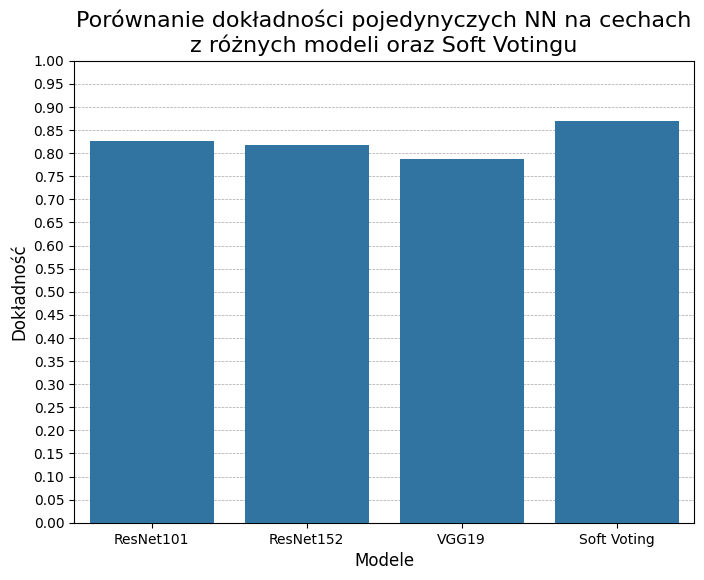

In [19]:
plt.figure(figsize=(8, 6))
acuracies = [accuracy_score(true, pred) for pred, true in models_data.values()]
sns.barplot(x=list(models_data.keys()), y=acuracies, zorder=3)
plt.grid(True, which='both', axis='y', linestyle='--', linewidth=0.5, color='gray', alpha=0.7, zorder=1)
plt.ylim(0, 1)
plt.yticks(np.arange(0, 1.05, 0.05))
plt.title("Porównanie dokładności pojedynyczych NN na cechach\nz różnych modeli oraz Soft Votingu", fontsize=16)
plt.xlabel("Modele", fontsize=12)
plt.ylabel("Dokładność", fontsize=12)
plt.show()

In [23]:
def plot_roc_curve_ovr(model_name, true, prob, classes):
    fpr = {}
    tpr = {}
    roc_auc = {}

    for i in range(len(classes)):
        fpr[i], tpr[i], _ = roc_curve(true, prob.detach().numpy()[:, i], pos_label=i)
        roc_auc[i] = auc(fpr[i], tpr[i])

    plt.figure(figsize=(10, 8))

    for i in range(len(classes)):
        plt.plot(fpr[i], tpr[i], label=f'{classes[i]} (pole = {roc_auc[i]:.2f})')

    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')

    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('Współczynnik fałszywie pozytywnych', fontsize=12)
    plt.ylabel('Współczynnik prawdziwie pozytywnych', fontsize=12)
    plt.title(f'Krzywe ROC (One-vs-Rest) - {model_name} trzech NN', fontsize=16)
    plt.legend(loc='lower right')
    plt.grid(True, which='both', axis='both', linestyle='--', linewidth=0.5, color='gray', alpha=0.7)

    plt.show()

C:\Users\alicj\AppData\Local\Temp\ipykernel_10360\2135968697.py:1: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  plot_roc_curve_ovr('Soft Voting', test_labels_resnet101, torch.tensor(soft_voting.predict(input)[1]), classes)


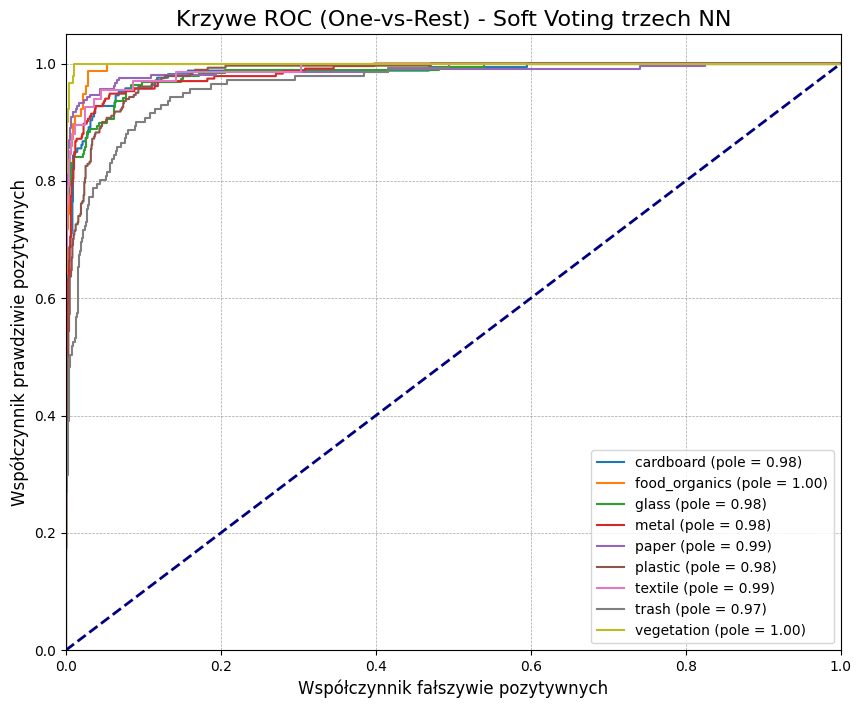

In [24]:
plot_roc_curve_ovr('Soft Voting', test_labels_resnet101, torch.tensor(soft_voting.predict(input)[1]), classes)

In [25]:
def plot_confusion_matrix(model_name, y_pred, y_true, classes):
    cm = confusion_matrix(y_true, y_pred)

    sns.heatmap(cm, annot=True, fmt="d", cmap="Greens", xticklabels=classes, yticklabels=classes)
    plt.xlabel('Przewidziane', fontsize=12)
    plt.ylabel('Rzeczywiste', fontsize=12)
    plt.title(f'Macierz pomyłek dla {model_name} trzech NN', fontsize=16, pad=20)
    plt.show()

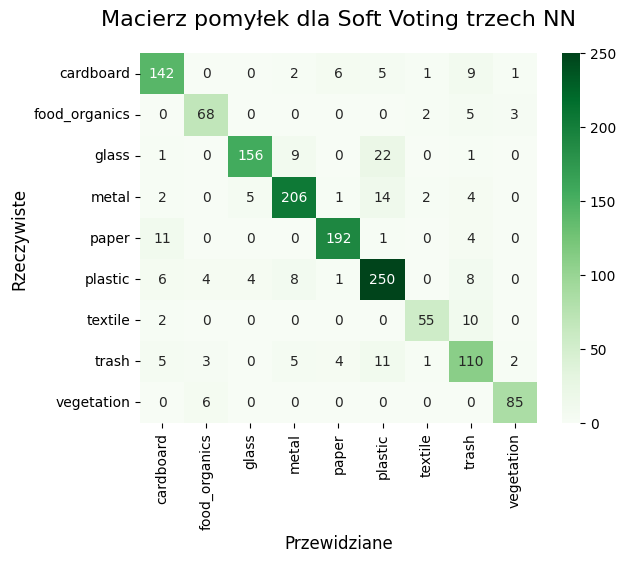

In [26]:
plot_confusion_matrix('Soft Voting', soft_voting.predict(input)[0], test_labels_resnet101, classes)

In [27]:
train_size, val_size, test_size = _calculate_sizes(dataset, 0.8)
_, _, test_dataset = _split_train_val_test(
    dataset, train_size, val_size, test_size, random_seed
)

In [30]:
from PIL import Image

def show_first_10_misclassified(model_name, label, pred, true, test_dataset):
    missclassified = [idx for idx in range(len(pred)) if pred[idx] != true[idx]]
    missclassified = [idx for idx in missclassified if true[idx] == label]
    indexes = [test_dataset.indices[idx] for idx in missclassified]

    num_images = min(len(indexes), 10)
    num_cols = min(5, num_images)
    if num_cols == 0:
        return
    num_rows = (num_images + num_cols - 1) // num_cols

    fig, axes = plt.subplots(num_rows, num_cols, figsize=(5 * num_cols, 4 * num_rows))
    if num_images == 10:
        fig.suptitle(f"Pierwsze 10 błędnie sklasyfikowanych obrazów z klasy {classes[label]} przez {model_name} trzech NN", fontsize=16)
    else:
        fig.suptitle(f"Błędnie sklasyfikowane obrazy z klasy {classes[label]} przez {model_name} trzech NN", fontsize=16)

    if num_rows == 1:
        axes = axes.reshape(1, num_cols)

    for i, idx in enumerate(indexes[:num_images]):
        ax = axes[i // num_cols, i % num_cols]

        image, true_label = test_dataset.dataset.samples[idx]
        image = Image.open(image)
        ax.imshow(image)
        ax.axis('off')
        ax.set_title(f'Rzeczywista: {classes[true_label]}\nPrzewidziana: {classes[pred[missclassified[i]]]}')

    for i in range(num_images, num_rows * num_cols):
        axes[i // num_cols, i % num_cols].axis('off')

    plt.tight_layout()
    plt.show()

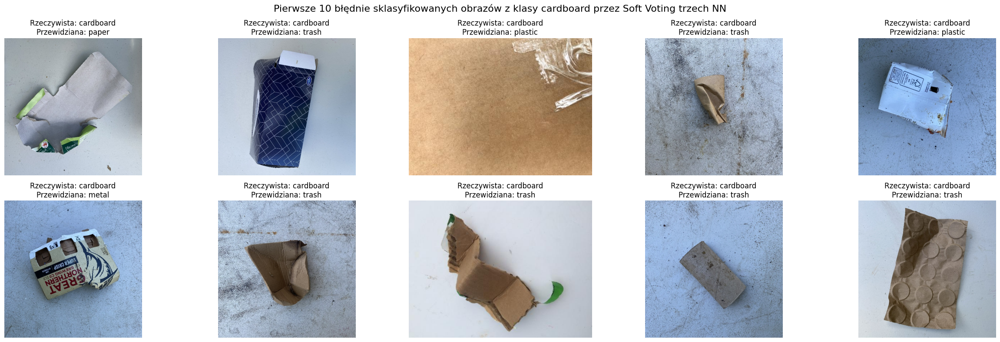

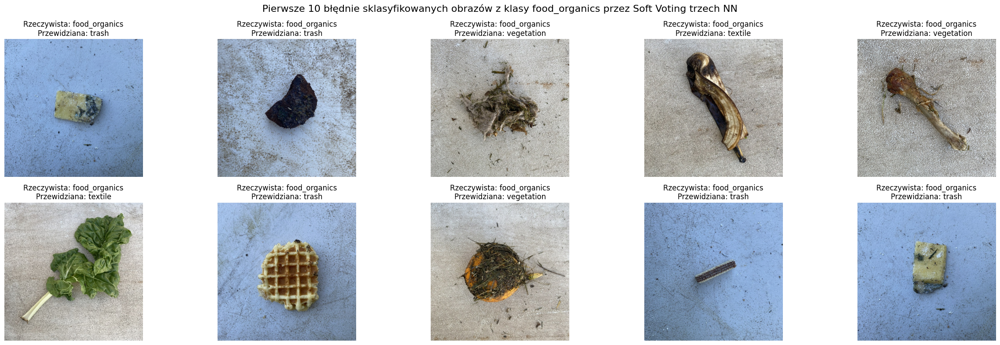

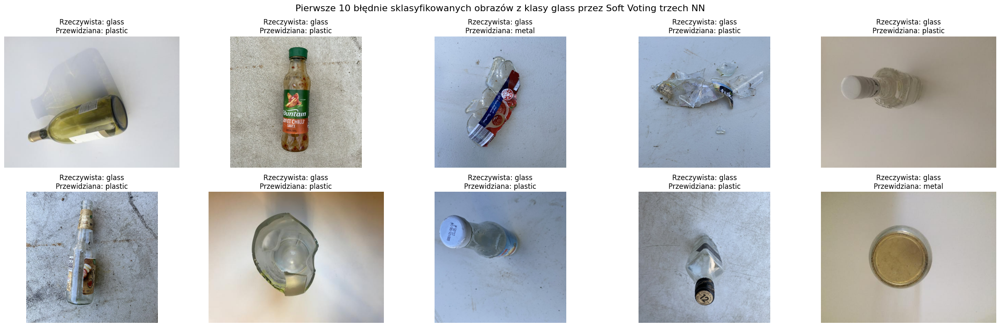

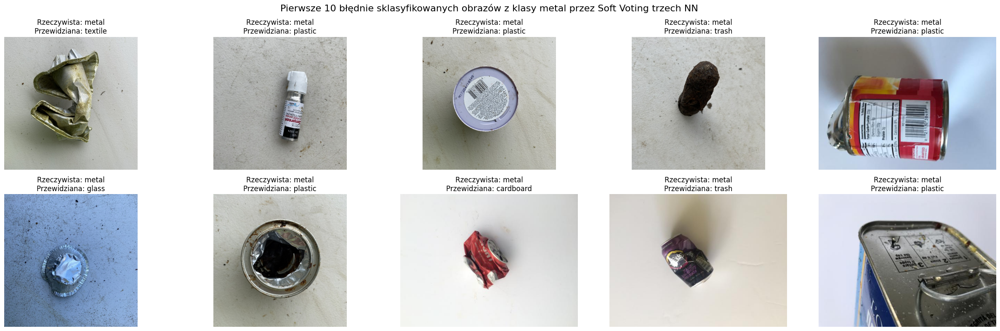

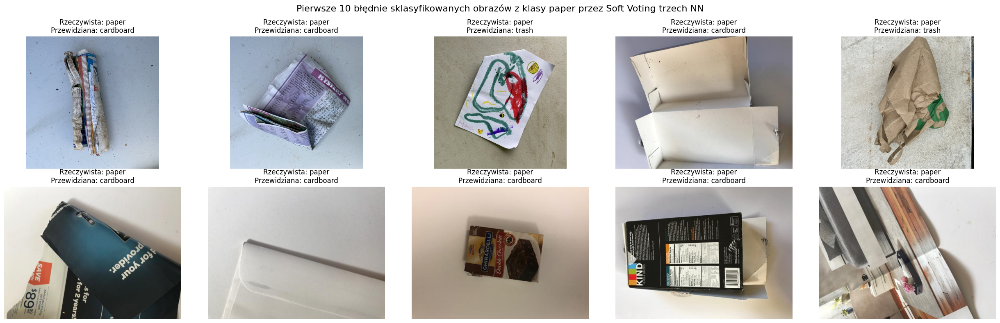

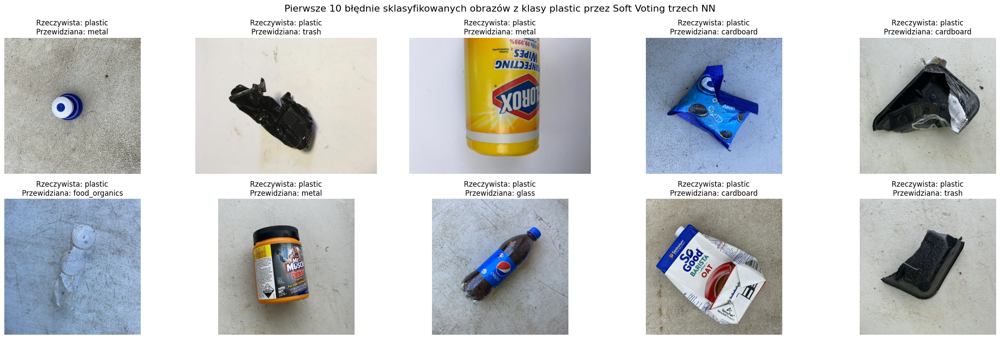

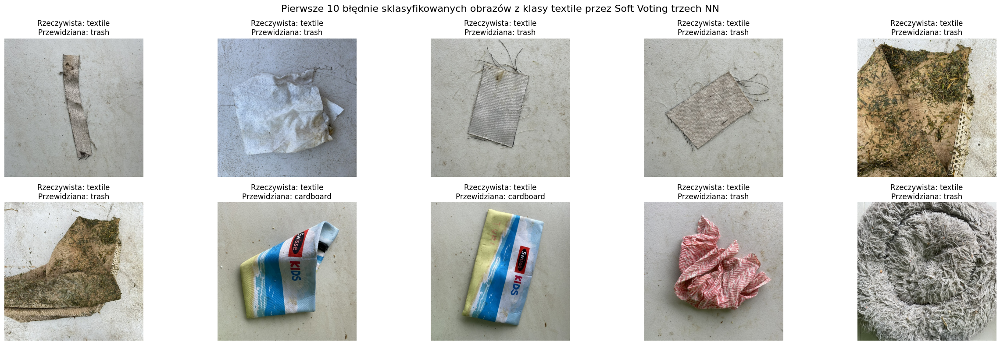

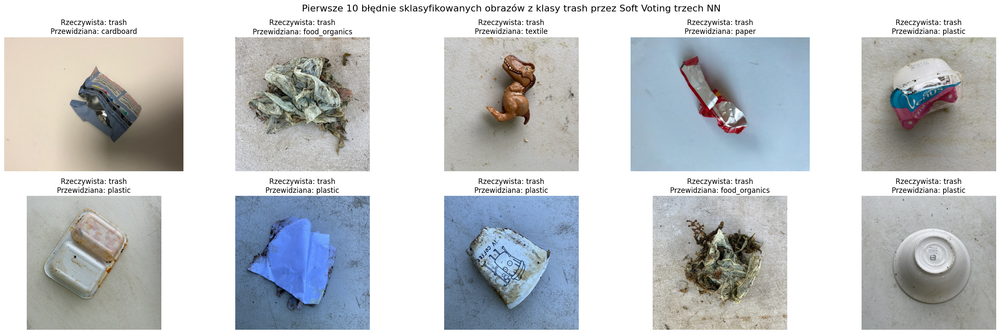

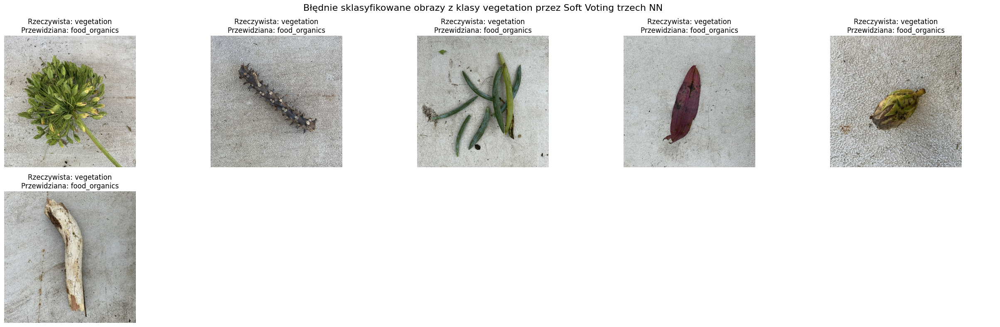

In [31]:
for i in range(9):
    show_first_10_misclassified('Soft Voting', i, soft_voting.predict(input)[0], test_labels_resnet101, test_dataset)